<a href="https://colab.research.google.com/github/cicyfan/robot-surface-classification/blob/master/robot_surface_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Robot Surface Classification

# Introduction

The goal of this project is to accurately classify the surface a robot was traveling on given time series data of orientation, acceleration, and angular velocity. The data is obtained from [Kaggle](https://www.kaggle.com/c/career-con-2019/data).

My approach to this project is as follows: First, I will pick a strong machine learning classifier model. In this case, I decided to stick with a Random Forest Classifier. I will then implement the "naive approach" to see how well the model performs and if there are any inherit biases. Furthermore, I will rely extensively on data visualization to explore relationship between features and surfaces and extract useful information. Armed with those information, I will then implment feature engineering to obtain derived features that will improve generalization. Finally, I will refine and retest until I achieve a good result. The refine and retest main entail things such as: adding or dropping feature, further feature engineering, adding or dropping derived features. Finally, there will be several concluding visualizations to explore the "intuition" behind the results.

With my final model, I was able to achieve a cross validation accuracy of **86%** and prediction accuracy of **95%** of the test set. Throught my iteration of models, I received the follow result of CV accuracy and prediction accuracy: 1) 99%, 77% 2) 42%, 41% 3) 87% 90% 4) 59%, 70%.



# ETL/EDA

[Kaggle set-up in colab ](https://towardsdatascience.com/setting-up-kaggle-in-google-colab-ebb281b61463)


## Import Libraries

In [0]:
import numpy as np 
import math
import pandas as pd 
import seaborn as sns
from scipy import stats
import matplotlib.pyplot as plt
%matplotlib inline
import altair as alt
alt.data_transformers.disable_max_rows()
import gc
gc.enable()
from scipy.stats import skew, kurtosis
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.metrics import accuracy_score

## Load Data

In [0]:
path='/content/drive/My Drive/data/robots/'
X_train = pd.read_csv(path+'X_train.csv', delimiter=',') 
y_train = pd.read_csv(path+'y_train.csv', delimiter=',') 
X_test = pd.read_csv(path+'X_test.csv', delimiter=',') 

In [0]:
X_train.info()
print(X_train.shape)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 487680 entries, 0 to 487679
Data columns (total 13 columns):
row_id                   487680 non-null object
series_id                487680 non-null int64
measurement_number       487680 non-null int64
orientation_X            487680 non-null float64
orientation_Y            487680 non-null float64
orientation_Z            487680 non-null float64
orientation_W            487680 non-null float64
angular_velocity_X       487680 non-null float64
angular_velocity_Y       487680 non-null float64
angular_velocity_Z       487680 non-null float64
linear_acceleration_X    487680 non-null float64
linear_acceleration_Y    487680 non-null float64
linear_acceleration_Z    487680 non-null float64
dtypes: float64(10), int64(2), object(1)
memory usage: 48.4+ MB
(487680, 13)


In [0]:
y_train.info()
print(y_train.shape)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3810 entries, 0 to 3809
Data columns (total 3 columns):
series_id    3810 non-null int64
group_id     3810 non-null int64
surface      3810 non-null object
dtypes: int64(2), object(1)
memory usage: 89.4+ KB
(3810, 3)


In [0]:
X_test.info()
print(X_test.shape)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 488448 entries, 0 to 488447
Data columns (total 13 columns):
row_id                   488448 non-null object
series_id                488448 non-null int64
measurement_number       488448 non-null int64
orientation_X            488448 non-null float64
orientation_Y            488448 non-null float64
orientation_Z            488448 non-null float64
orientation_W            488448 non-null float64
angular_velocity_X       488448 non-null float64
angular_velocity_Y       488448 non-null float64
angular_velocity_Z       488448 non-null float64
linear_acceleration_X    488448 non-null float64
linear_acceleration_Y    488448 non-null float64
linear_acceleration_Z    488448 non-null float64
dtypes: float64(10), int64(2), object(1)
memory usage: 48.4+ MB
(488448, 13)


In [0]:
y_train.shape[0] == X_train.shape[0]/128

True

From the above, we can conclude that X_train includes time series data for each series_id. For each series, there are 128 recordings of movement (ie features). For each series_id, y_train provides the categorical information on the surface the robot was traveling on. 

In [0]:
X_train.describe()

,series_id,measurement_number,orientation_X,orientation_Y,orientation_Z,orientation_W,angular_velocity_X,angular_velocity_Y,angular_velocity_Z,linear_acceleration_X,linear_acceleration_Y,linear_acceleration_Z
count,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000
mean,1904.500000,63.500000,-0.018050,0.075062,0.012458,-0.003804,0.000178,0.008338,-0.019184,0.129281,2.886468,-9.364886
std,1099.853353,36.949327,0.685696,0.708226,0.105972,0.104299,0.117764,0.088677,0.229153,1.870600,2.140067,2.845341
min,0.000000,0.000000,-0.989100,-0.989650,-0.162830,-0.156620,-2.371000,-0.927860,-1.268800,-36.067000,-121.490000,-75.386000
25%,952.000000,31.750000,-0.705120,-0.688980,-0.089466,-0.106060,-0.040752,-0.033191,-0.090743,-0.530833,1.957900,-10.193000
50%,1904.500000,63.500000,-0.105960,0.237855,0.031949,-0.018704,0.000084,0.005412,-0.005335,0.124980,2.879600,-9.365300
75%,2857.000000,95.250000,0.651803,0.809550,0.122870,0.097215,0.040527,0.048068,0.064604,0.792263,3.798800,-8.522700
max,3809.000000,127.000000,0.989100,0.988980,0.155710,0.154770,2.282200,1.079100,1.387300,36.797000,73.008000,65.839000


In [0]:
feature_cols = list(X_train.columns)[3:]
print(feature_cols)

['orientation_X', 'orientation_Y', 'orientation_Z', 'orientation_W', 'angular_velocity_X', 'angular_velocity_Y', 'angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y', 'linear_acceleration_Z']


In [0]:
no_orient_cols = feature_cols[-6:]
print(no_orient_cols)

['angular_velocity_X', 'angular_velocity_Y', 'angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y', 'linear_acceleration_Z']


## Split Data


In [0]:
# split X_train
samples = 20
time_series = 128
start_x = X_train.shape[0] - samples*time_series
X_train_new, X_test_new = X_train.iloc[:start_x], X_train.iloc[start_x:]
# split y_train
start_y = y_train.shape[0] - samples
y_train_new, y_test_new = y_train.iloc[:start_y], y_train.iloc[start_y:]

In [0]:
X_test_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2560 entries, 485120 to 487679
Data columns (total 13 columns):
row_id                   2560 non-null object
series_id                2560 non-null int64
measurement_number       2560 non-null int64
orientation_X            2560 non-null float64
orientation_Y            2560 non-null float64
orientation_Z            2560 non-null float64
orientation_W            2560 non-null float64
angular_velocity_X       2560 non-null float64
angular_velocity_Y       2560 non-null float64
angular_velocity_Z       2560 non-null float64
linear_acceleration_X    2560 non-null float64
linear_acceleration_Y    2560 non-null float64
linear_acceleration_Z    2560 non-null float64
dtypes: float64(10), int64(2), object(1)
memory usage: 260.1+ KB


## Label Encode

Encode surface labels from string (fine_conrete, soft_tiles, etc) to a integer (0, 1, ..., n)

[Documentation](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.LabelEncoder.html)

In [0]:
print(y_train)

      series_id  group_id        surface
0             0        13  fine_concrete
1             1        31       concrete
2             2        20       concrete
3             3        31       concrete
4             4        22     soft_tiles
...         ...       ...            ...
3805       3805        55          tiled
3806       3806        67           wood
3807       3807        48  fine_concrete
3808       3808        54          tiled
3809       3809        56       soft_pvc

[3810 rows x 3 columns]


In [0]:
label = LabelEncoder()
label.fit(y_train_new['surface'])
y_train_label = label.transform(y_train_new['surface'])
y_test_label = label.transform(y_test_new['surface'])
y_train_label_repeat=y_train_label.repeat(128)
y_test_label_repeat=y_test_label.repeat(128)

# Exploratory Visulization

### Surface Labels 
Total of 9 surfaces, with concrete being the most frequent, followed by soft pvc








In [0]:
count_column = y_train.surface.value_counts(normalize=True)
print(count_column)
alt.Chart(y_train).mark_bar().encode(
    y=alt.Y('surface:O', sort='-x'),
    x='count(surface)',
    color='surface'
).properties(
    width=500,
    height=300
).interactive()

concrete                  0.204462
soft_pvc                  0.192126
wood                      0.159318
tiled                     0.134908
fine_concrete             0.095276
hard_tiles_large_space    0.080840
soft_tiles                0.077953
carpet                    0.049606
hard_tiles                0.005512
Name: surface, dtype: float64


alt.Chart(...)

### Group ID
73 different group ids, each group id contains only one surface classification.  \\
This might be a interesting feature as it provides an alternative grouping from series ID.

In [0]:
count_column = y_train.group_id.value_counts(normalize=True)
print(count_column)
alt.Chart(y_train).mark_bar().encode(
    x='group_id:O',
    y='count(group_id)',
    color='surface'
).properties(
    width=500,
    height=300
).interactive()

40    0.018635
44    0.018635
53    0.018635
60    0.018635
70    0.018635
        ...   
5     0.002362
58    0.001837
67    0.001575
24    0.001312
30    0.000787
Name: group_id, Length: 73, dtype: float64


alt.Chart(...)

### Features - Correlation Matrix


*   Perfect positive correlation: orientation_w and orientation_x, orientation_z and orientation_y
*   Strong Positive correlation: linear_accerlation_z and linear acceleration_y

*   Strong Negative correlation: angular_velocity_z and angular_velocity_y

**Each feature category (orientation, acceleration, angular velocity) seems to be highly correlated within itself.** 



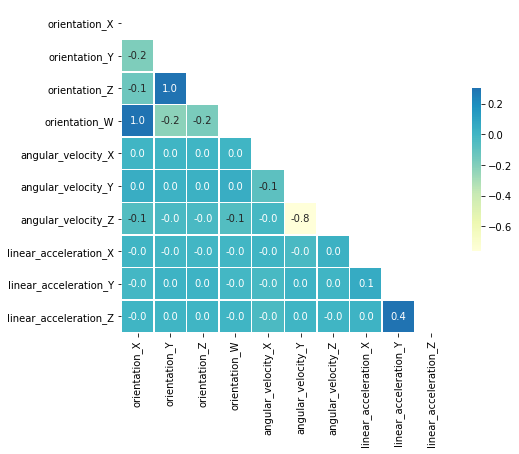

In [0]:
corr = X_train.drop(['series_id', 'measurement_number'],1).corr()
f, ax = plt.subplots(figsize=(9, 6))
mask = np.triu(np.ones_like(corr, dtype=np.bool))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap="YlGnBu", vmax=.3, center=0, annot=True, fmt= '.1f',\
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

### Features - view time series data per sample
In each sample, acceleration and velocity data seem to vary, while orientation stays the same or with very little changes. 

In [0]:
# changing the series id here to view time series graph of different series
series_id = 9
to_plot = X_train[X_train['series_id']==series_id].drop(['series_id','row_id'], axis=1)
print(y_train[y_train['series_id']==series_id])

   series_id  group_id surface
9          9        11   tiled


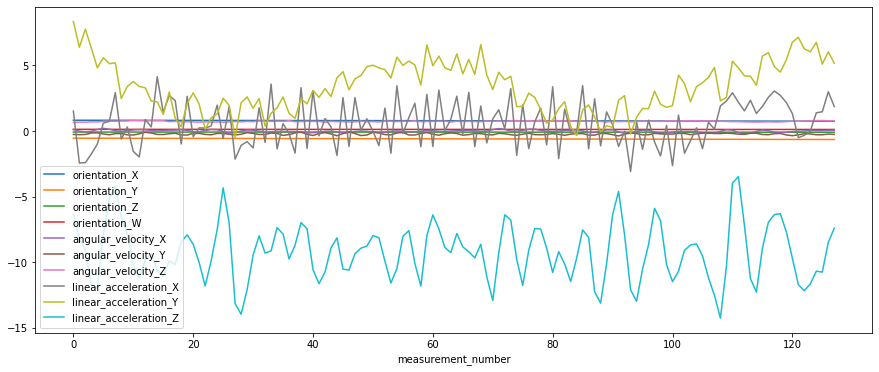

In [0]:
line_plot = to_plot.set_index('measurement_number')
plt.figure(figsize=(15,6))
sns.lineplot(data=line_plot, dashes=False)

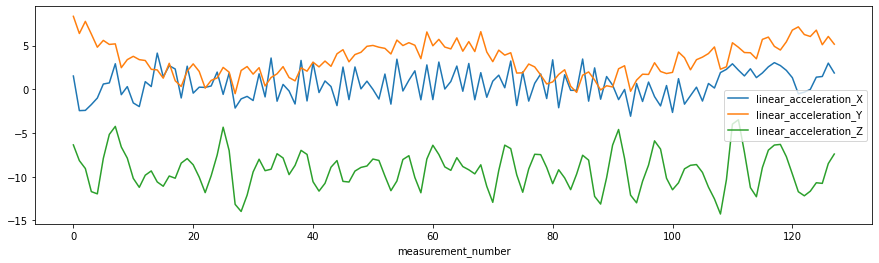

In [0]:
line_plot1 = line_plot.iloc[:,7:]
plt.figure(figsize=(15,4))
sns.lineplot(data=line_plot1, dashes=False)

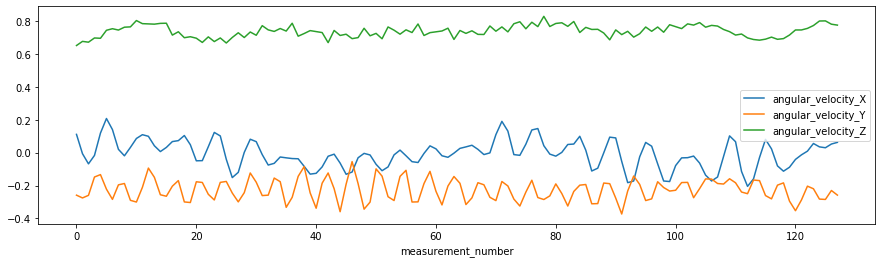

In [0]:
line_plot2 = line_plot.iloc[:,4:7]
plt.figure(figsize=(15,4))
sns.lineplot(data=line_plot2, dashes=False)

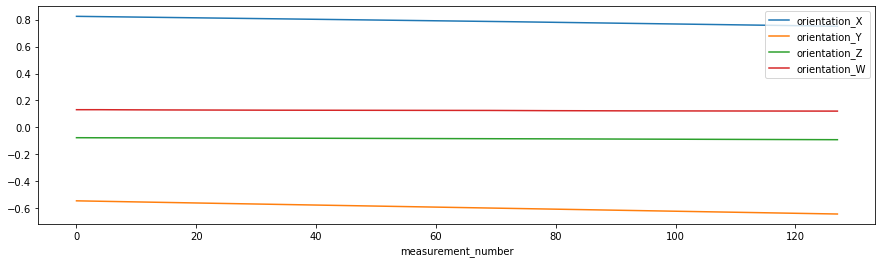

In [0]:
line_plot3 = line_plot.iloc[:,0:4]
plt.figure(figsize=(15,4))
sns.lineplot(data=line_plot3, dashes=False)

# Random Forest - naive approach

[Introduction to Random Forest](https://towardsdatascience.com/random-forest-classification-and-its-implementation-d5d840dbead0)  \\
[Explaination of Random Forest](https://towardsdatascience.com/an-implementation-and-explanation-of-the-random-forest-in-python-77bf308a9b76) \\
[Explaination of Bagging](https://machinelearningmastery.com/bagging-and-random-forest-ensemble-algorithms-for-machine-learning/) \\

After understanding the data a bit better, we can begin to pick a model. My first thought was to start with Random Forest Classifier. As an ensemble tree-based learning algorithm, the Random Forest Classifier is a set of decision trees from randomly selected subset of training set. An ensemble method is a technique that combines the predictions from multiple machine learning algorithms together to make more accurate predictions than any individual model. Further more, random subsets of features are considered when splitting nodes. The randomness is an important feature, as it leads to de-correlation between tree predictions and improves generalization. 

The multiple trees allow for a probabilistic classification: a majority vote among estimators gives an estimate of the probability (accessed in Scikit-Learn with the predict_proba() method).

I will start with training the model with all ten features provided in x_train.csv as is. I will mainly rely on two metrics to check on performace: 1) average accuracy from 5 fold cross validation 2) accuracy score between predicted labels by the model and y_test. I will also examine the feature importance with the feature_importance_() method to gain a better understanding of our model's logic. During cross valiation, the sorted feature importance will be printed anytime the accuracy score is above a arbitrary threshold.


### Train the model 

In [0]:
data = X_train_new[feature_cols]
target = y_train_label_repeat
test = X_test_new[feature_cols]
labels = y_test_label_repeat

In [0]:
rfmodel = RandomForestClassifier(n_jobs=-1) 
rfmodel.fit(data, target)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=None, verbose=0,
                       warm_start=False)

### Performance - naive approach

In [0]:
rfmodel.score(data, target)

1.0

In [0]:
accuracy_score(rfmodel.predict(test), labels)

0.779296875

Ranked feature importance

In [0]:
feature_rank = np.stack((feature_cols, rfmodel.feature_importances_), axis=1)
print(feature_rank[feature_rank[:,1].argsort()[::-1]])

[['orientation_W' '0.17767725972283216']
 ['orientation_Z' '0.17763482210537743']
 ['orientation_X' '0.17605608344734047']
 ['orientation_Y' '0.15436375836759908']
 ['angular_velocity_Z' '0.13113834927974194']
 ['angular_velocity_Y' '0.05462418564603395']
 ['linear_acceleration_X' '0.03487388710661095']
 ['linear_acceleration_Z' '0.033804496556287825']
 ['linear_acceleration_Y' '0.03012458031286087']
 ['angular_velocity_X' '0.029702577455315217']]


### Cross Validation - Stratified KFold

[Cross Validation Reference](https://towardsdatascience.com/train-test-split-and-cross-validation-in-python-80b61beca4b6)


<img src="https://scikit-learn.org/stable/_images/sphx_glr_plot_cv_indices_007.png" width="400">

[Image Source with CV visualization](https://scikit-learn.org/stable/_images/sphx_glr_plot_cv_indices_007.png)

In [0]:
def cross_validate(data, target, test, splits, threshold):
  folds = StratifiedKFold(n_splits=splits, shuffle=True, random_state=59)
  predicted = np.zeros((test.shape[0], 9)) #9 different surface areas
  measured= np.zeros((data.shape[0]))
  totalscore = 0
  
  for times, (trn_idx, val_idx) in enumerate(folds.split(data, target)):
      rfmodel = RandomForestClassifier(n_estimators=100, n_jobs = -1)
      rfmodel.fit(data.iloc[trn_idx],target[trn_idx])
      measured[val_idx] = rfmodel.predict(data.iloc[val_idx])
      predicted += rfmodel.predict_proba(test)/splits
      totalscore += rfmodel.score(data.iloc[val_idx],target[val_idx])
      print("Fold: {} Score: {}".format(times, rfmodel.score(data.iloc[val_idx], target[val_idx])))
      
      if rfmodel.score(data.iloc[val_idx],target[val_idx]) > threshold:
        feature_rank = np.stack((data.columns, rfmodel.feature_importances_), axis=1)
        print(feature_rank[feature_rank[:,1].argsort()[::-1]])    

      gc.collect()
  avgaccuracy = totalscore / splits
  return measured, predicted, avgaccuracy

In [0]:
measured, predicted, accuracy = cross_validate(data, target, test, 5, 0.9886)

Fold: 0 Score: 0.9881575692612137
Fold: 1 Score: 0.9877556068601583
Fold: 2 Score: 0.9884770778364116
Fold: 3 Score: 0.9883121701846965
Fold: 4 Score: 0.9883740105540897


In [0]:
print('Avg CV Accuracy:', accuracy)

Avg CV Accuracy: 0.988215286939314


In [0]:
accuracy_score(predicted.argmax(axis=1), labels)

0.776953125

### Takeaway
This naive approach generated a very high cross validation accuracy of 99%, and predicted the test set with 78% accuracy. This seems way too good to be true. As discussed in our Slack channel, this phenomenom is due to leakage within the training dataset, as outlined [here](https://www.kaggle.com/anjum48/leakage-within-the-train-dataset), where the kernel author was able to achieve a CV score of 0.992 with just the orientation data. This is also evident in the ranked feature importance where the weights heavily skewed towards the orientation data. This begs the question: **How well will the naive approach perform without the orientation data?**

# Random Forest - no orientation features



### Train the Model


In [0]:
data = X_train_new[no_orient_cols]
test = X_test_new[no_orient_cols]
print(no_orient_cols)

['angular_velocity_X', 'angular_velocity_Y', 'angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y', 'linear_acceleration_Z']


In [0]:
rfmodel = RandomForestClassifier(n_jobs=-1) 
rfmodel.fit(data, target)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=None, verbose=0,
                       warm_start=False)

### Performance

In [0]:
rfmodel.score(data, target)

1.0

In [0]:
accuracy_score(rfmodel.predict(test), labels)

0.408984375

In [0]:
feature_rank = np.stack((no_orient_cols, rfmodel.feature_importances_), axis=1)
print(feature_rank[feature_rank[:,1].argsort()[::-1]])

[['angular_velocity_Z' '0.18473148749399418']
 ['linear_acceleration_X' '0.16706631098514363']
 ['linear_acceleration_Z' '0.1655807941555094']
 ['angular_velocity_Y' '0.163701300958508']
 ['angular_velocity_X' '0.1609528616624559']
 ['linear_acceleration_Y' '0.157967244744389']]


### Cross Validation

In [0]:
measured, predicted, accuracy = cross_validate(data, target, test, 5, 0.42)

Fold: 0 Score: 0.4177935356200528
Fold: 1 Score: 0.4200507091029024
[['angular_velocity_Z' 0.183559283005822]
 ['linear_acceleration_X' 0.1668730323382318]
 ['linear_acceleration_Z' 0.16577622304423395]
 ['angular_velocity_Y' 0.1650386171918358]
 ['angular_velocity_X' 0.16107157712890582]
 ['linear_acceleration_Y' 0.15768126729097065]]
Fold: 2 Score: 0.4202568436675462
[['angular_velocity_Z' 0.18525275829087953]
 ['linear_acceleration_X' 0.16680464345490784]
 ['linear_acceleration_Z' 0.1654095703477917]
 ['angular_velocity_Y' 0.16321044561728312]
 ['angular_velocity_X' 0.16153565135420958]
 ['linear_acceleration_Y' 0.15778693093492827]]
Fold: 3 Score: 0.4234828496042216
[['angular_velocity_Z' 0.1832810050112755]
 ['linear_acceleration_Z' 0.16691157236905999]
 ['linear_acceleration_X' 0.16651756175154775]
 ['angular_velocity_Y' 0.16409336201212768]
 ['angular_velocity_X' 0.1609952975006045]
 ['linear_acceleration_Y' 0.15820120135538457]]
Fold: 4 Score: 0.42038052440633245
[['angular_vel

In [0]:
print('Avg CV Accuracy:', accuracy)

Avg CV Accuracy: 0.42039289248021106


In [0]:
accuracy_score(predicted.argmax(axis=1), labels)

0.41953125

## Takeaway
The model performed quite poorly when it was only trained on linear acceleration and angular velocity data. Before opting for testing of another model, I want to explore the features a little more through visualization and see if I can find some more observable patterns.

# More Data Visualization before Feature Engineering

<img src="http://www.starlino.com/wp-content/uploads/data/imu_guide/acc_gyro_axes.png" width="300">

## Orientation Matrix Scatter Plot

There is a clear pattern in the scatter plot matrix with many of them forming circles. The circle is espicially "uniform" when x is plotted against y. We can see that $x^2 + y^2 = 1$, which means there is very little 'tilt' in the z dimension. Since $x^2 + y^2 = 1$ is also the equation of a circle, when x is plotted against y, it will always form a cicle on our graphs. We can conclude that the robot is travelling on a mostly flat surface, and not climbing up a steep slope. 

In [0]:
df1 = X_train.merge(y_train)
rows = ['orientation_X','orientation_Y', 'orientation_Z', 'orientation_W']
columns = rows[::-1]
alt.Chart(df1.sample(n=500)).mark_circle().encode(
    alt.X(alt.repeat("column"), type='quantitative'),
    alt.Y(alt.repeat("row"), type='quantitative'),
    color='surface:N'
).properties(
    width=150,
    height=150
).repeat(
    row=rows,
    column=columns
).interactive()

alt.RepeatChart(...)

## Linear Acceleration vs Angular Velocity Scatter Plot
This scatter plot did not create a clear pattern. Perhaps because there is no clear relationship to be observed between the two features. Additionally, due to the number of catergorical data (surface types), it becomes harder to observe a pattern due to the colors. 

In [0]:
alt.Chart(df1.sample(n=500)).mark_circle().encode(
    alt.X('linear_acceleration_X', scale=alt.Scale(zero=False)),
    alt.Y('angular_velocity_X', scale=alt.Scale(zero=False, padding=1)),
    color='surface'
).properties(
    width=700,
    height=300
).interactive()

alt.Chart(...)

## Feature Histogram Across Surfaces
There might not be a clear relationship between linear acceleration and angular velocity, however, we can see that there are distinct distribution of each of the feature across different surfaces. 

In [0]:
alt.Chart(df1.sample(n=500)).mark_area(
    opacity=1,
    interpolate='step'
).encode(
    alt.X('linear_acceleration_X:Q', bin=alt.Bin(maxbins=100)),
    alt.Y('count()', stack=None),
    alt.Color('surface:N')
).properties(
    width=150,
    height=150
).facet(
    facet='surface:N',
    columns=3
).interactive()

alt.FacetChart(...)

In [0]:
alt.Chart(df1.sample(n=500)).mark_area(
    opacity=1,
    interpolate='step'
).encode(
    alt.X('angular_velocity_X:Q', bin=alt.Bin(maxbins=100)),
    alt.Y('count()', stack=None),
    alt.Color('surface:N')
).properties(
    width=150,
    height=150
).facet(
    facet='surface:N',
    columns=3
).interactive()

alt.FacetChart(...)

In [0]:
alt.Chart(df1.sample(n=500)).mark_area(
    opacity=1,
    interpolate='step'
).encode(
    alt.X('orientation_X:Q', bin=alt.Bin(maxbins=100)),
    alt.Y('count()', stack=None),
    alt.Color('surface:N')
).properties(
    width=150,
    height=150
).facet(
    facet='surface:N',
    columns=3
).interactive()

alt.FacetChart(...)

## Takeaway
Since we know that the robots are mostly traveling on flat surfaces, we can infer that the difference in distribution of linear acceleration and angular velocity is due to the type of surface it is traveling on. It is quite intuitive that the way a robot travels on a carpeted surface, a bumpy sufcace with high friction, would be different from smooth frictionless concrete. A good way to capture that "variance" would be to reduce the 128 points of time series data to 1 point of summary statistics that can include things such as min, max, mean, etc. 

# Random Forest - time series feature extraction

## Summarize Time Series Data
I will start off by extracting all of the common summary statistics. I suspect not all of them will be useful.

In [0]:
def fe_summarize(data):
  df = pd.DataFrame()
  for col in data.columns:
      if col in ['row_id','series_id','measurement_number']: 
          continue
      df[col + '_mean'] = data.groupby(['series_id'])[col].mean()
      df[col + '_median'] = data.groupby(['series_id'])[col].median()
      df[col + '_max'] = data.groupby(['series_id'])[col].max()
      df[col + '_min'] = data.groupby(['series_id'])[col].min()
      df[col + '_std'] = data.groupby(['series_id'])[col].std()
      df[col + '_range'] = df[col + '_max'] - df[col + '_min']
      df[col + '_maxtoMin'] = df[col + '_max'] / df[col + '_min']
      df[col + '_mean_abs_chg'] = data.groupby(['series_id'])[col].apply(lambda x: np.mean(np.abs(np.diff(x))))
      df[col + '_mean_abs_dev'] = data.groupby(['series_id'])[col].apply(lambda x: stats.median_absolute_deviation(x))
      df[col + '_abs_max'] = data.groupby(['series_id'])[col].apply(lambda x: np.max(np.abs(x)))
      df[col + '_abs_min'] = data.groupby(['series_id'])[col].apply(lambda x: np.min(np.abs(x)))
      df[col + '_abs_avg'] = (df[col + '_abs_min'] + df[col + '_abs_max'])/2

  gc.collect()
  return df

## With Orientation Data

In [0]:
feature_cols.append('series_id') 
print(feature_cols)

['orientation_X', 'orientation_Y', 'orientation_Z', 'orientation_W', 'angular_velocity_X', 'angular_velocity_Y', 'angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y', 'linear_acceleration_Z', 'series_id']


In [0]:
data = X_train_new[feature_cols]
test = X_test_new[feature_cols]
data_fe = fe_summarize(data)
test_fe = fe_summarize(test)

data_fe.fillna(0, inplace = True)
data_fe.replace(-np.inf, 0, inplace = True)
data_fe.replace(np.inf, 0, inplace = True)
test_fe.fillna(0, inplace = True)
test_fe.replace(-np.inf, 0, inplace = True)
test_fe.replace(np.inf, 0, inplace = True)

print(data_fe.columns)

Index(['orientation_X_mean', 'orientation_X_median', 'orientation_X_max',
       'orientation_X_min', 'orientation_X_std', 'orientation_X_range',
       'orientation_X_maxtoMin', 'orientation_X_mean_abs_chg',
       'orientation_X_mean_abs_dev', 'orientation_X_abs_max',
       ...
       'linear_acceleration_Z_max', 'linear_acceleration_Z_min',
       'linear_acceleration_Z_std', 'linear_acceleration_Z_range',
       'linear_acceleration_Z_maxtoMin', 'linear_acceleration_Z_mean_abs_chg',
       'linear_acceleration_Z_mean_abs_dev', 'linear_acceleration_Z_abs_max',
       'linear_acceleration_Z_abs_min', 'linear_acceleration_Z_abs_avg'],
      dtype='object', length=120)


In [0]:
measured, predicted, accuracy = cross_validate(data_fe, y_train_label, test_fe, 5, 0.889)

Fold: 0 Score: 0.8825857519788918
Fold: 1 Score: 0.8641160949868074
Fold: 2 Score: 0.8654353562005277
Fold: 3 Score: 0.8786279683377308
Fold: 4 Score: 0.8812664907651715


In [0]:
print(accuracy)

0.8744063324538258


In [0]:
accuracy_score(predicted.argmax(axis=1), y_test_label)

0.9

## Takeaway
With the time series data summarized and its feature statistics extracted, this model still performed questionably well with a 88% CV accuracy. Orientation and their derived features still dominate the higher ranked feature importance. Interestingly, linear acceleration and thier derived features also took several of the top spots. This echoed my conclusions from my visualizations. \\

Similar to the previous sections, I will repeat the same process in the next section and see how well this methodology will perform without orientation data.

## Without Orientation Data

In [0]:
no_orient_cols.append('series_id')
print(no_orient_cols)

['angular_velocity_X', 'angular_velocity_Y', 'angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y', 'linear_acceleration_Z', 'series_id']


In [0]:
data = X_train_new[no_orient_cols]
test = X_test_new[no_orient_cols]
data_fe = fe_summarize(data)
test_fe = fe_summarize(test)

data_fe.fillna(0, inplace = True)
data_fe.replace(-np.inf, 0, inplace = True)
data_fe.replace(np.inf, 0, inplace = True)
test_fe.fillna(0, inplace = True)
test_fe.replace(-np.inf, 0, inplace = True)
test_fe.replace(np.inf, 0, inplace = True)

In [0]:
measured, predicted, accuracy = cross_validate(data_fe, y_train_label, test_fe, 5, 0.6)

Fold: 0 Score: 0.5778364116094987
Fold: 1 Score: 0.5963060686015831
Fold: 2 Score: 0.5923482849604221
Fold: 3 Score: 0.5976253298153035
Fold: 4 Score: 0.5910290237467019


In [0]:
print('Avg CV Accuracy:', accuracy)

Avg CV Accuracy: 0.5910290237467019


In [0]:
accuracy_score(predicted.argmax(axis=1), y_test_label)

0.7

## Takeaway
Removing the orientation data significantly lowers of CV accuracy. However, interestingly, the accuracy of our predicted labels and true labels **improved to 70% from 42%** in the previous section with no feature extraction.

# Random Forest - Final Model

## Feature Engineering

<img src="http://www.chrobotics.com/wp-content/uploads/2012/11/F18-1024x655.png" width="400">

I will implement some further feature engineering that I believe will help my model generalize better. Firstly, I will be extracting roll/pitch/yaw (euler angles) from quaternion angles. Quaternions angles have two parts, a scalar part known as 'w' and an imaginary part known as (x,y,z). Euler angles are more intuitive to humans and easier to conceptulize. I will also be calculating the total movement of each features using the formula $\sqrt{x^2+y^2+z^2}$. The summary statistics from these derived features will then be extracted. 

I iterated through different variations of the fe_summarize(data) function and achieved the best result by dropping some features.

[Converting Euler Angles to Quaternions](https://stackoverflow.com/questions/53033620/how-to-convert-euler-angles-to-quaternions-and-get-the-same-euler-angles-back-fr?rq=1)

In [0]:
def quaternion_to_euler(x, y, z, w):
  t0 = +2.0 * (w * x + y * z)
  t1 = +1.0 - 2.0 * (x * x + y * y)
  X = math.atan2(t0, t1)

  t2 = +2.0 * (w * y - z * x)
  t2 = +1.0 if t2 > +1.0 else t2
  t2 = -1.0 if t2 < -1.0 else t2
  Y = math.asin(t2)

  t3 = +2.0 * (w * z + x * y)
  t4 = +1.0 - 2.0 * (y * y + z * z)
  Z = math.atan2(t3, t4)

  return X, Y, Z

In [0]:
def fe_summarize(data):
  df = pd.DataFrame()
  
  for col in data.columns:
      if col in ['row_id','series_id','measurement_number','orientation_X', 'orientation_Y', 'orientation_Z', 'orientation_W']:
          continue
      df[col + '_mean'] = data.groupby(['series_id'])[col].mean()
      # df[col + '_median'] = data.groupby(['series_id'])[col].median()
      df[col + '_max'] = data.groupby(['series_id'])[col].max()
      df[col + '_min'] = data.groupby(['series_id'])[col].min()
      #df[col + '_std'] = data.groupby(['series_id'])[col].std()
      #df[col + '_range'] = df[col + '_max'] - df[col + '_min']
      df[col + '_maxtoMin'] = df[col + '_max'] / df[col + '_min']
      df[col + '_mean_abs_dev'] = data.groupby(['series_id'])[col].apply(lambda x: stats.median_absolute_deviation(x))
      df[col + '_mean_abs_chg'] = data.groupby(['series_id'])[col].apply(lambda x: np.mean(np.abs(np.diff(x))))
      # df[col + '_abs_max'] = data.groupby(['series_id'])[col].apply(lambda x: np.max(np.abs(x)))
      # df[col + '_abs_min'] = data.groupby(['series_id'])[col].apply(lambda x: np.min(np.abs(x)))
      # df[col + '_abs_avg'] = (df[col + '_abs_min'] + df[col + '_abs_max'])/2

  gc.collect()
  return df

In [0]:
def fe(data):    
  df = pd.DataFrame()
  df['series_id'] = data['series_id']
  df['total_anglr_vel'] = (data['angular_velocity_X']**2 + data['angular_velocity_Y']**2 +
                            data['angular_velocity_Z']**2)** 0.5
  df['total_linr_acc'] = (data['linear_acceleration_X']**2 + data['linear_acceleration_Y']**2 +
                            data['linear_acceleration_Z'])**0.5
  #df['total_xyz'] = (data['orientation_X']**2 + data['orientation_Y']**2 + data['orientation_Z'])**0.5
  df['euler_X'], df['euler_Y'], df['euler_Z'] = zip(*data.apply(lambda x: quaternion_to_euler(x['orientation_X'], x['orientation_Y'], x['orientation_Z'], x['orientation_W']), axis=1))
  df['total_angle'] = (df['euler_X']**2 + df['euler_Y']**2 + df['euler_Z']**2)**0.5

  gc.collect()
  return df

In [0]:
columns = ['series_id', 'angular_velocity_X', 'angular_velocity_Y', 'angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y', 'linear_acceleration_Z']
data = fe(X_train_new[feature_cols]).merge(X_train_new[columns])
test = fe(X_test_new[feature_cols]).merge(X_test_new[columns])

In [0]:
data_fe = fe_summarize(data)
test_fe = fe_summarize(test)

data_fe.fillna(0, inplace = True)
data_fe.replace(-np.inf, 0, inplace = True)
data_fe.replace(np.inf, 0, inplace = True)
test_fe.fillna(0, inplace = True)
test_fe.replace(-np.inf, 0, inplace = True)
test_fe.replace(np.inf, 0, inplace = True)

print(data_fe.columns)

Index(['total_anglr_vel_mean', 'total_anglr_vel_max', 'total_anglr_vel_min',
       'total_anglr_vel_maxtoMin', 'total_anglr_vel_mean_abs_dev',
       'total_anglr_vel_mean_abs_chg', 'total_linr_acc_mean',
       'total_linr_acc_max', 'total_linr_acc_min', 'total_linr_acc_maxtoMin',
       'total_linr_acc_mean_abs_dev', 'total_linr_acc_mean_abs_chg',
       'euler_X_mean', 'euler_X_max', 'euler_X_min', 'euler_X_maxtoMin',
       'euler_X_mean_abs_dev', 'euler_X_mean_abs_chg', 'euler_Y_mean',
       'euler_Y_max', 'euler_Y_min', 'euler_Y_maxtoMin',
       'euler_Y_mean_abs_dev', 'euler_Y_mean_abs_chg', 'euler_Z_mean',
       'euler_Z_max', 'euler_Z_min', 'euler_Z_maxtoMin',
       'euler_Z_mean_abs_dev', 'euler_Z_mean_abs_chg', 'total_angle_mean',
       'total_angle_max', 'total_angle_min', 'total_angle_maxtoMin',
       'total_angle_mean_abs_dev', 'total_angle_mean_abs_chg',
       'angular_velocity_X_mean', 'angular_velocity_X_max',
       'angular_velocity_X_min', 'angular_velocity_

## Cross Validation

In [0]:
measured, predicted, accuracy = cross_validate(data_fe, y_train_label, test_fe, 5, 0.86)

Fold: 0 Score: 0.8693931398416886
[['total_angle_max' 0.04013422154419767]
 ['total_angle_min' 0.03963038660714146]
 ['euler_Z_max' 0.03899002170148086]
 ['euler_Z_mean' 0.03708052647787671]
 ['total_angle_mean' 0.036295196129953355]
 ['euler_Z_min' 0.035807562390238246]
 ['linear_acceleration_Z_mean_abs_chg' 0.030142399410038406]
 ['euler_Y_max' 0.02880398449644836]
 ['euler_Y_mean' 0.028530007708678515]
 ['euler_Y_min' 0.02826109851867016]
 ['linear_acceleration_Y_mean_abs_chg' 0.02228996041990548]
 ['linear_acceleration_X_mean_abs_chg' 0.022107472293976468]
 ['euler_Z_maxtoMin' 0.020896915189013054]
 ['linear_acceleration_Z_mean_abs_dev' 0.019472596637648974]
 ['angular_velocity_Y_mean_abs_chg' 0.018372994322625798]
 ['linear_acceleration_Z_min' 0.017975198012982405]
 ['total_linr_acc_max' 0.017948698996214804]
 ['angular_velocity_X_mean_abs_chg' 0.01711624718104319]
 ['euler_X_mean' 0.016316440227758286]
 ['euler_X_min' 0.01583973364583963]
 ['euler_X_max' 0.01574368448497485]
 ['l

In [0]:
print(accuracy)

0.8593667546174142


In [0]:
accuracy_score(predicted.argmax(axis=1), y_test_label)

0.9

# Final Results Visulization

## Visualizing top features across surfaces


In [0]:
plot = pd.concat([data_fe,y_train_new['surface'], y_train_new['series_id']],axis=1)

In [0]:
alt.Chart(plot).mark_bar().encode(
    y='surface:O',
    x='total_linr_acc_max:Q',
    color='surface'
).properties(
    width=500,
    height=300
).interactive()

alt.Chart(...)

In [0]:
alt.Chart(plot).mark_bar().encode(
    y='surface:O',
    x='total_anglr_vel_max',
    color='surface'
).properties(
    width=500,
    height=300
).interactive()

alt.Chart(...)

In [0]:
alt.Chart(plot).mark_bar().encode(
    y='surface:O',
    x='linear_acceleration_Z_mean_abs_chg',
    color='surface'
).properties(
    width=500,
    height=300
).interactive()

alt.Chart(...)

In [0]:
gc.collect()

## Euler_Z vs Euler_Y
Some clustering pattern can be observed.

In [0]:
df = pd.DataFrame()
df['euler_X'], df['euler_Y'], df['euler_Z'] = zip(*X_train_new.apply(lambda x: quaternion_to_euler(x['orientation_X'], x['orientation_Y'], x['orientation_Z'], x['orientation_W']), axis=1))

In [0]:
y_train_repeat=np.array(y_train['surface']).repeat(128)
df1 = pd.concat([df, pd.DataFrame(y_train_repeat, columns=['surface'])],axis=1)
print(df.columns)

Index(['euler_X', 'euler_Y', 'euler_Z'], dtype='object')


In [0]:
alt.Chart(df1.sample(n=1000)).mark_circle().encode(
    alt.X('euler_Z', scale=alt.Scale(zero=False)),
    alt.Y('euler_Y', scale=alt.Scale(zero=False, padding=1)),
    color='surface'
).properties(
    width=700,
    height=300
).interactive()

alt.Chart(...)

# Conclusion

Three important takeaways:


1.   It is important to have a good understanding of the data. Visulization helps.
2.   More features or derived features does not always lead to higher accuracy.
3.   Your model is only as good as the data you train it on.

